In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import datetime

In [16]:
df = pd.read_csv('Data/data_cleaned.csv')

In [3]:
df['time'] = pd.to_datetime(df['time'])

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 132 entries, 0 to 131
Data columns (total 22 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   post_id             132 non-null    int64         
 1   post_text           132 non-null    object        
 2   time                132 non-null    datetime64[ns]
 3   images_description  132 non-null    object        
 4   comments            132 non-null    int64         
 5   shares              132 non-null    int64         
 6   comments_full       132 non-null    object        
 7   reaction_count      132 non-null    int64         
 8   image_id            128 non-null    float64       
 9   image_ids           132 non-null    object        
 10  fetched_time        132 non-null    object        
 11  thích               132 non-null    int64         
 12  yêu thích           132 non-null    int64         
 13  haha                132 non-null    int64         

In [9]:
df.loc[100]['post_text']

'BỮA ĂN 26K CỦA LÊ ANH NUÔI VÀ 800K CỦA CÁC VẬN ĐỘNG VIÊN BÓNG BÀN TRẺ QUỐC GIA\nBên trên là những bữa cơm trị giá 26K của Tiktoker Lê Anh Nuôi nấu ăn tại đơn vị. Còn bên dưới là một bàn ăn trị giá khoảng 800K cho 8 người ăn dành cho các em tại đội tuyển bóng bàn trẻ quốc gia theo như Báo Tiền Phong cung cấp. Ngoài ra, còn phần thức ăn sáng bao gồm "xôi và chai nước ngọt" trị giá 100K.\nHai khẩu phần ăn với mức giá khác biệt nhau. Nhưng chúng ta hẳn sẽ cảm thấy khẩu phần ăn 26K/1 người còn ngon hơn, tốt hơn, cân đối hơn khẩu phần ăn trị giá 100K/1 người. Tại sao lại như vậy?\nGần tối biết tin này, mình đảo thử qua một siêu thị gần nhà. Với mức chi phí 800K thì có thể mua được tới 1 cân sườn vai heo, 1 cân cá thu, 1 cân thịt bò, 1 cân thịt bắp heo. Dĩ nhiên là còn dư tiền để mua rau củ, sữa sau bữa ăn nữa... Chứ không phải dăm ba thứ đồ ăn lèo teo như thế.\nMột điều đáng nói là ở khái niệm "y học thể thao". Trong đó có vấn đề dinh dưỡng thể thao, các đầu bếp sẽ nấu ra các món ăn nhằm gi

In [4]:
df['comment_sentiment'] = df['comment_sentiment'].apply(lambda x: eval(x))

In [5]:
df['comment_sentiment'][0]

{'POS': 30, 'NEG': 48, 'NEU': 25}

In [6]:
df[['comment_POS', 'comment_NEG', 'comment_NEU']] = pd.DataFrame(df['comment_sentiment'].tolist(), index=df.index)

In [7]:
df['length'] = df['post_text'].str.len()

In [11]:
df[['comments','shares','reaction_count','thích', 'yêu thích', 'haha', 'wow', 'thương thương', 'buồn', 'phẫn nộ','length']].describe()

,comments,shares,reaction_count,thích,yêu thích,haha,wow,thương thương,buồn,phẫn nộ,length
count,132.000000,132.000000,132.000000,132.000000,132.000000,132.000000,132.000000,132.000000,132.000000,132.00000,132.000000
mean,521.113636,222.340909,9864.992424,7215.545455,1778.318182,465.750000,10.621212,103.863636,281.840909,9.05303,2037.469697
std,748.477015,407.753964,18197.269534,12486.994156,4177.537376,2399.841895,16.623597,253.472638,1240.802996,39.08814,1564.363219
min,31.000000,7.000000,1663.000000,1444.000000,10.000000,1.000000,0.000000,1.000000,0.000000,0.00000,116.000000
25%,136.000000,46.250000,3536.250000,2596.000000,268.000000,6.000000,2.000000,14.750000,2.000000,0.00000,713.000000
50%,242.000000,91.500000,5242.500000,4000.500000,742.000000,16.000000,5.000000,37.000000,9.000000,1.00000,1579.000000
75%,507.000000,186.250000,8221.750000,6394.000000,1517.500000,96.750000,11.000000,84.750000,44.250000,3.00000,3137.250000
max,4457.000000,2447.000000,133764.000000,93182.000000,39210.000000,25961.000000,107.000000,2179.000000,12967.000000,390.00000,6716.000000


In [159]:
# Top 5 posts
df['total_reactions'] = df['reaction_count'] + df['comments'] + df['shares']
top_5_posts = df.nlargest(5, 'total_reactions')
top_5_posts[['post_id', 'post_text', 'total_reactions','time']]

,post_id,post_text,total_reactions,time
92,301615012501092,CHỦ QUYỀN TỔ QUỐC LÀ TỐI THƯỢNG!\nTrong trận đ...,138901,2023-09-24 17:12:25
27,272741568721770,Cùng lứa với Hoa hậu Ý Nhi (đi thi hoa hậu để ...,128996,2023-07-29 16:11:00
24,271796398816287,THANH XUÂN CỦA NHỮNG NGƯỜI LÍNH ĐÁNG GIÁ BAO N...,100015,2023-07-27 20:43:28
30,274234811905779,Đây là lần đầu chúng ta tham gia World Cup nữ ...,49267,2023-08-01 15:59:12
9,267739662555294,MỘT ĐIỆP VIÊN CỦA VIỆT NAM ĐỦ KHIẾN NHỮNG JAME...,40551,2023-07-19 20:03:12


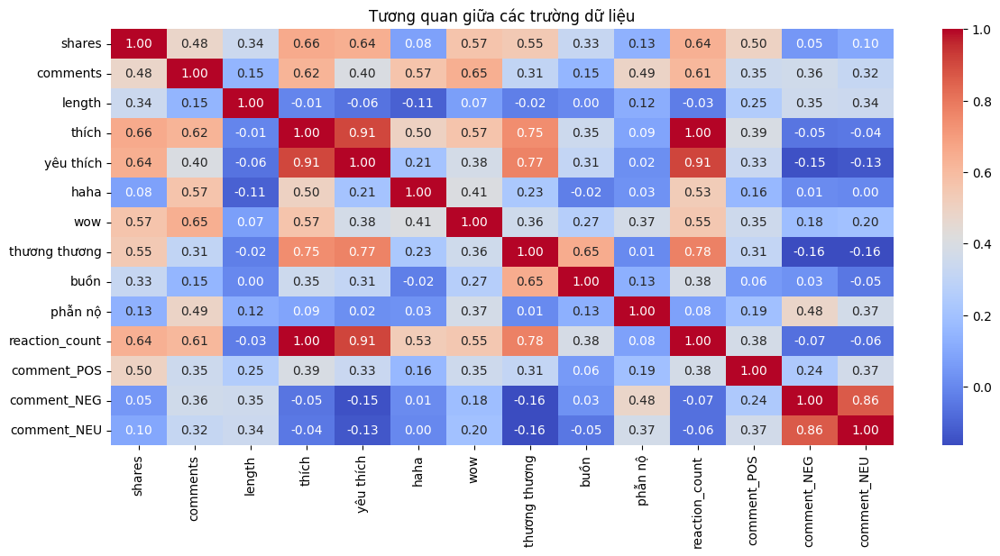

In [13]:
correlation_matrix = df[['shares', 'comments', 'length','thích', 'yêu thích', 'haha', 'wow', 'thương thương', 'buồn', 'phẫn nộ','reaction_count','comment_POS','comment_NEG','comment_NEU']].corr()
plt.figure(figsize=(14,6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Tương quan giữa các trường dữ liệu')
plt.show()

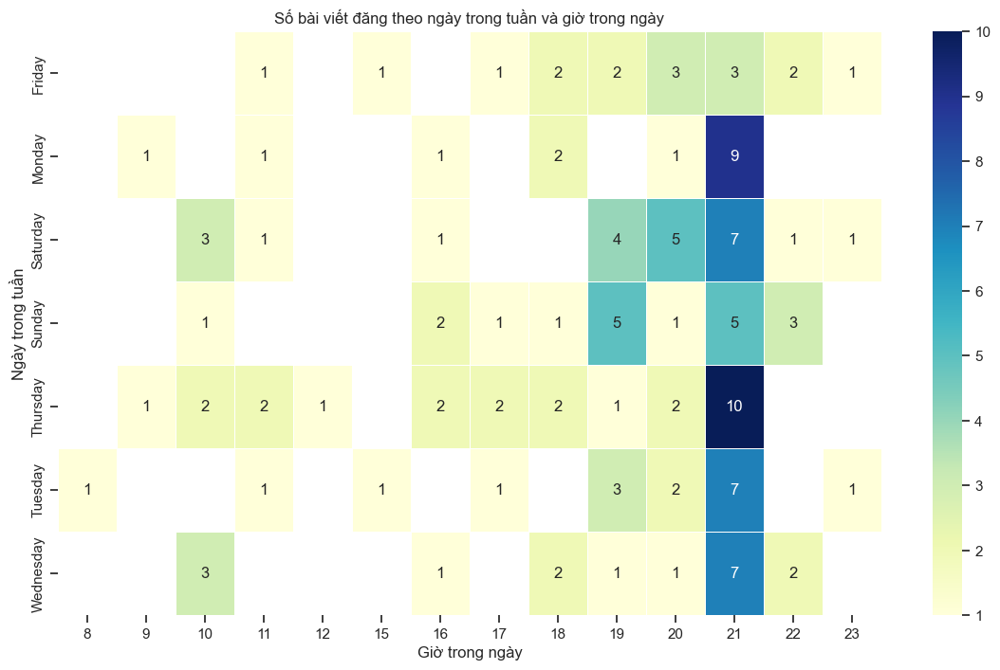

In [63]:
df['day'] = df['time'].dt.day_name()
df['hour'] = df['time'].dt.hour

# Tạo biểu đồ heatmap cho số bài viết đăng theo ngày trong tuần và giờ trong ngày
plt.figure(figsize=(14, 8))
heatmap_data = df.groupby(['day', 'hour']).size().unstack()
sns.heatmap(heatmap_data, cmap='YlGnBu', annot=True, fmt='g', linewidths=.5)
plt.title('Số bài viết đăng theo ngày trong tuần và giờ trong ngày')
plt.xlabel('Giờ trong ngày')
plt.ylabel('Ngày trong tuần')
plt.show()

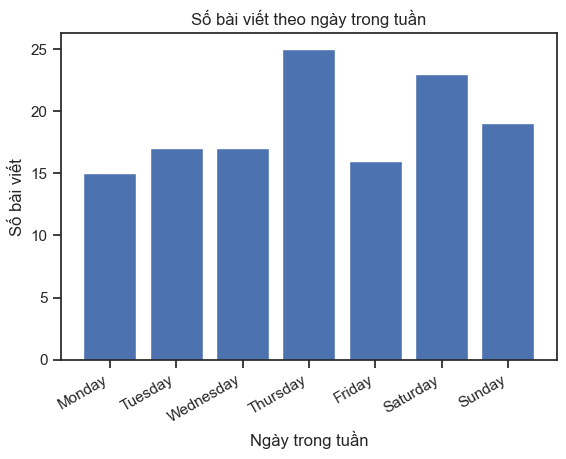

In [64]:
# Đếm số bài viết theo ngày trong tuần
posts_by_day = df['day'].value_counts()

# Sắp xếp theo thứ tự ngày trong tuần
posts_by_day = posts_by_day.reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Vẽ biểu đồ cột
plt.bar(posts_by_day.index, posts_by_day.values)
plt.title('Số bài viết theo ngày trong tuần')
plt.gcf().autofmt_xdate()
plt.xlabel('Ngày trong tuần')
plt.ylabel('Số bài viết')
plt.show()

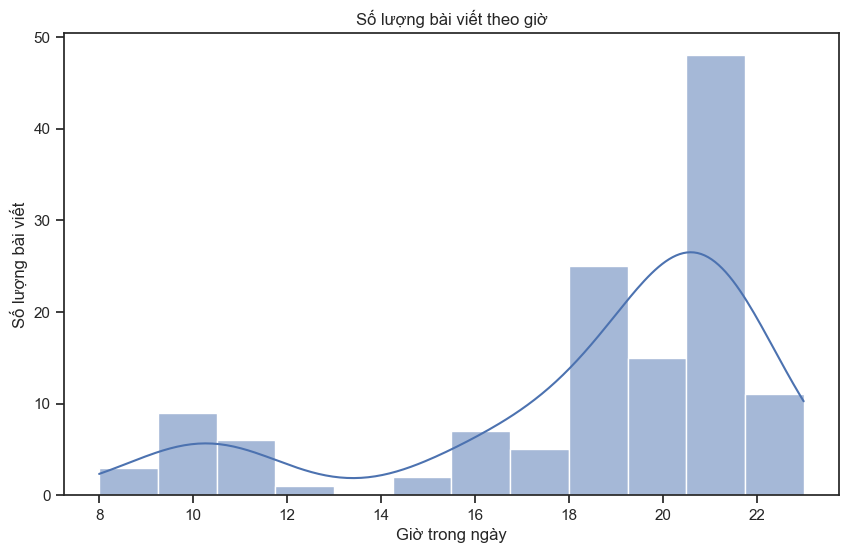

In [68]:
plt.figure(figsize=(10, 6))
sns.histplot(df['hour'], kde=True)
plt.title('Số lượng bài viết theo giờ')
plt.xlabel('Giờ trong ngày')
plt.ylabel('Số lượng bài viết')
plt.show()

In [18]:
# Set the 'time' column as the index
df.set_index('time', inplace=True)

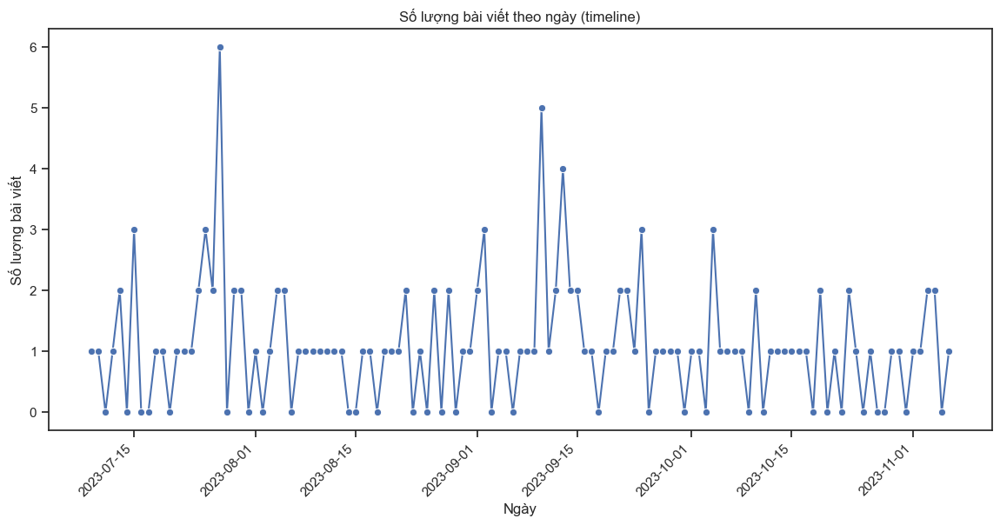

In [77]:
posts_per_day = df.resample('D').size()

# Plot the number of posts over time (timeline)
plt.figure(figsize=(14, 6))
sns.lineplot(x=posts_per_day.index, y=posts_per_day.values, marker='o', linestyle='-')
plt.title('Số lượng bài viết theo ngày')
plt.xlabel('Ngày')
plt.ylabel('Số lượng bài viết')
plt.axhline(df[''].mean(), color='red', linewidth=2, label='Trung vị')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.show()

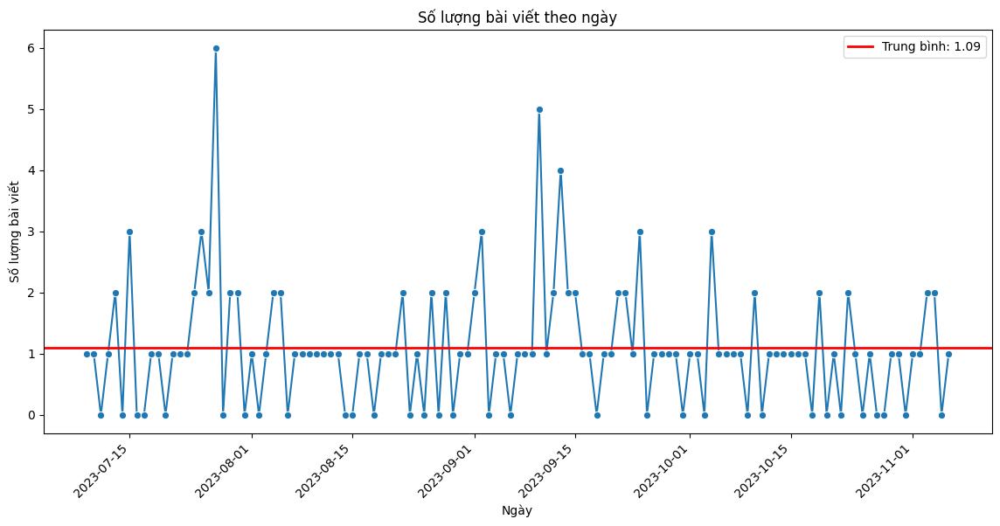

In [14]:
posts_per_day = df.resample('D').size()

# Plot the number of posts over time (timeline)
plt.figure(figsize=(14, 6))
sns.lineplot(x=posts_per_day.index, y=posts_per_day.values, marker='o', linestyle='-')
plt.title('Số lượng bài viết theo ngày')
plt.xlabel('Ngày')
plt.ylabel('Số lượng bài viết')

# Calculate and plot the mean line
mean_posts = posts_per_day.mean()
plt.axhline(mean_posts, color='red', linewidth=2, label=f'Trung bình: {mean_posts:.2f}')

plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.legend()  # Add legend to the plot
plt.show()

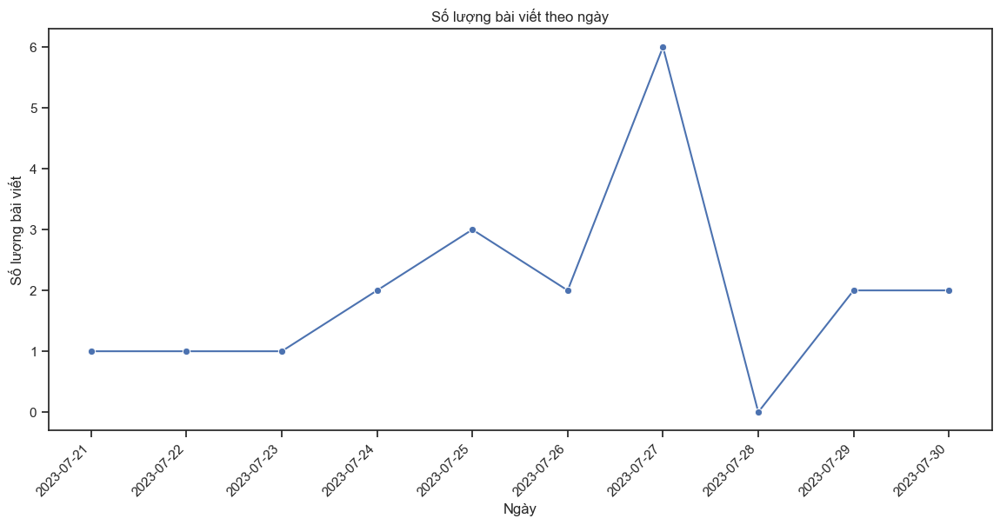

In [87]:
posts_per_day = df.loc[(df.index >= pd.to_datetime('2023-07-20')) & (df.index <= pd.to_datetime('2023-08-01'))].resample('D').size()
# Plot the number of posts over time (timeline)
plt.figure(figsize=(14, 6))
sns.lineplot(x=posts_per_day.index, y=posts_per_day.values, marker='o', linestyle='-')
plt.title('Số lượng bài viết theo ngày')
plt.xlabel('Ngày')
plt.ylabel('Số lượng bài viết')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.show()

In [88]:
start_date = pd.to_datetime('2023-07-26')
end_date = pd.to_datetime('2023-07-28')
selected_posts = df.loc[(df.index >= start_date) & (df.index <= end_date)]

In [34]:
from wordcloud import WordCloud
with open('vietnamese-stopwords-dash.txt', 'r', encoding='utf-8') as file:
        lines = [line.strip() for line in file]
stop_words = set(lines)
stop_words.add('_tifosi')
stop_words.add('Tifosi')
stop_words.add('tifosi')
def key_words(text):
    wordcloud = WordCloud(stopwords=stop_words,
                            background_color='white', 
                            max_words=300,
                            width=2000, height=1200,
                            ).generate(text)
    plt.figure(figsize=(40,20))
    plt.clf()
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.show()
        

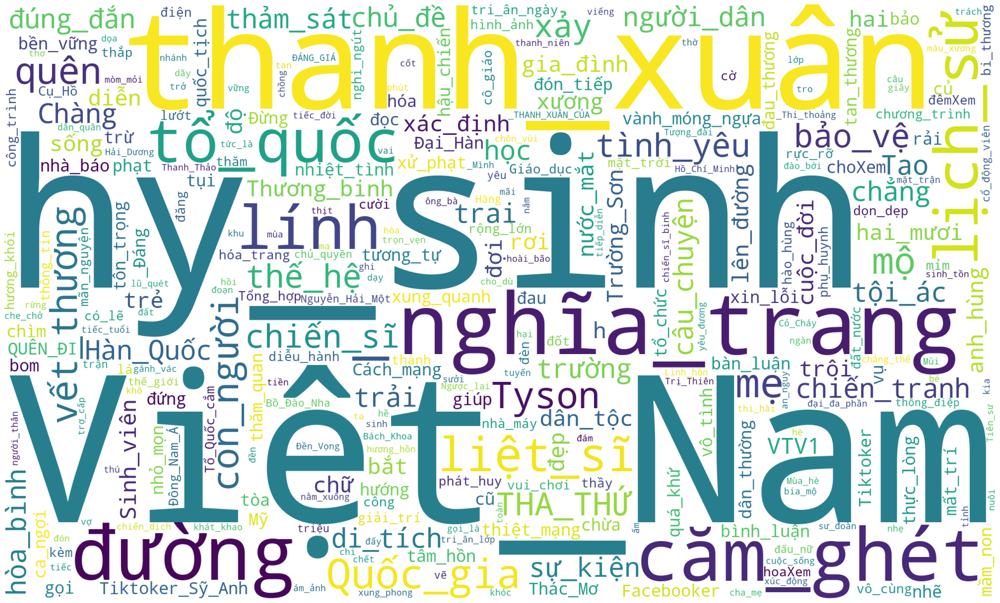

In [93]:
from underthesea import word_tokenize
text = ' '.join(selected_posts['post_text'].dropna())
text = word_tokenize(text, format='text')
key_words(text)

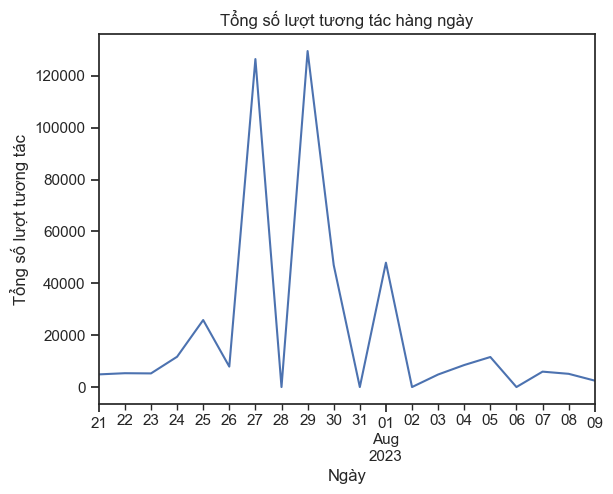

In [99]:
df.loc[(df.index >= pd.to_datetime('2023-07-20')) & (df.index <= pd.to_datetime('2023-08-10'))]['reaction_count'].resample('D').sum().plot(title='Tổng số lượt tương tác hàng ngày')
plt.xlabel('Ngày')
plt.ylabel('Tổng số lượt tương tác')
plt.show()

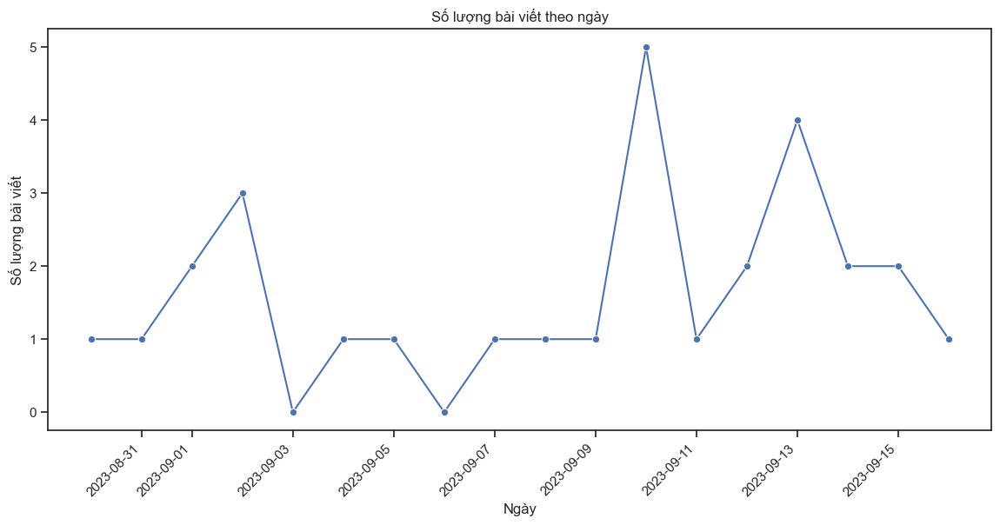

In [120]:
posts_per_day = df.loc[(df.index >= pd.to_datetime('2023-08-30')) & (df.index <= pd.to_datetime('2023-09-17'))].resample('D').size()
# Plot the number of posts over time (timeline)
plt.figure(figsize=(14, 6))
sns.lineplot(x=posts_per_day.index, y=posts_per_day.values, marker='o', linestyle='-')
plt.title('Số lượng bài viết theo ngày')
plt.xlabel('Ngày')
plt.ylabel('Số lượng bài viết')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.show()

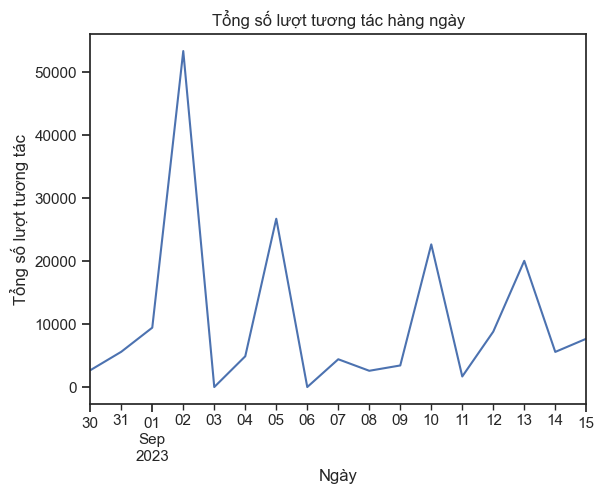

In [125]:
df.loc[(df.index >= pd.to_datetime('2023-08-30')) & (df.index <= pd.to_datetime('2023-09-16'))]['reaction_count'].resample('D').sum().plot(title='Tổng số lượt tương tác hàng ngày')
plt.xlabel('Ngày')
plt.ylabel('Tổng số lượt tương tác')
plt.show()

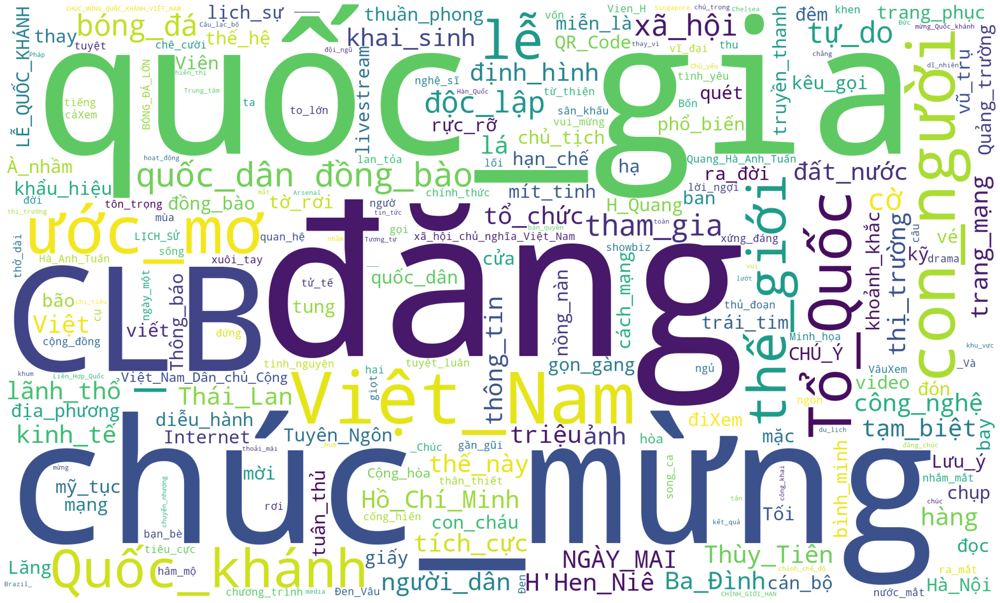

In [121]:
selected_post_4 = df.loc[(df.index >= pd.to_datetime('2023-09-01')) & (df.index <= pd.to_datetime('2023-09-03'))]
text_4 = ' '.join(selected_post_4['post_text'].dropna())
text_4 = word_tokenize(text_4, format='text')
key_words(text_4)

In [102]:
selected_post_2 = df.loc[(df.index >= pd.to_datetime('2023-09-9')) & (df.index <= pd.to_datetime('2023-09-11'))]

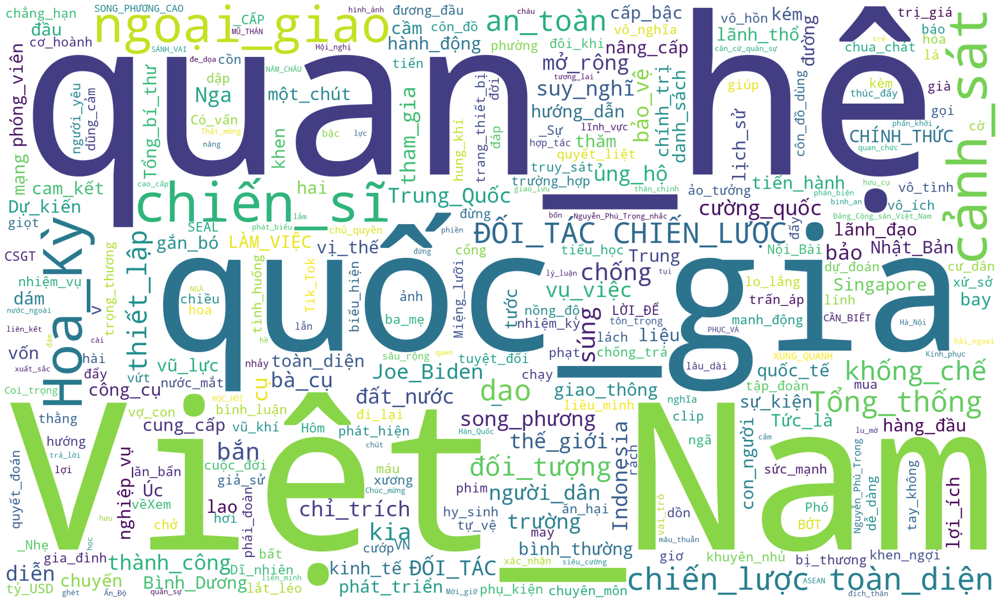

In [103]:
text_2 = ' '.join(selected_post_2['post_text'].dropna())
text_2 = word_tokenize(text_2, format='text')
key_words(text_2)

In [107]:
selected_post_3 = df.loc[(df.index >= pd.to_datetime('2023-09-12')) & (df.index <= pd.to_datetime('2023-09-15'))]

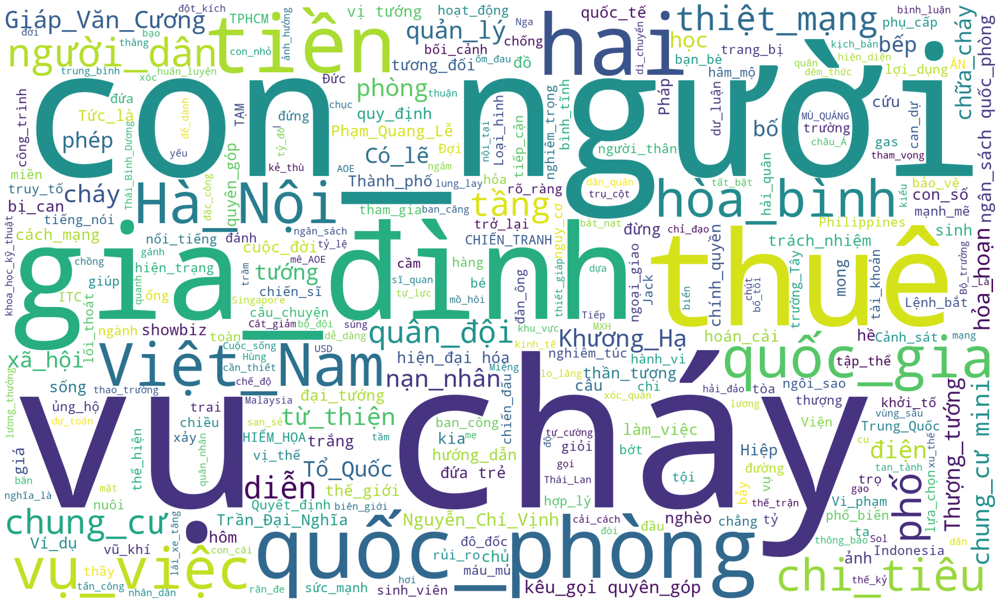

In [108]:
text_3 = ' '.join(selected_post_3['post_text'].dropna())
text_3 = word_tokenize(text_3, format='text')
key_words(text_3)

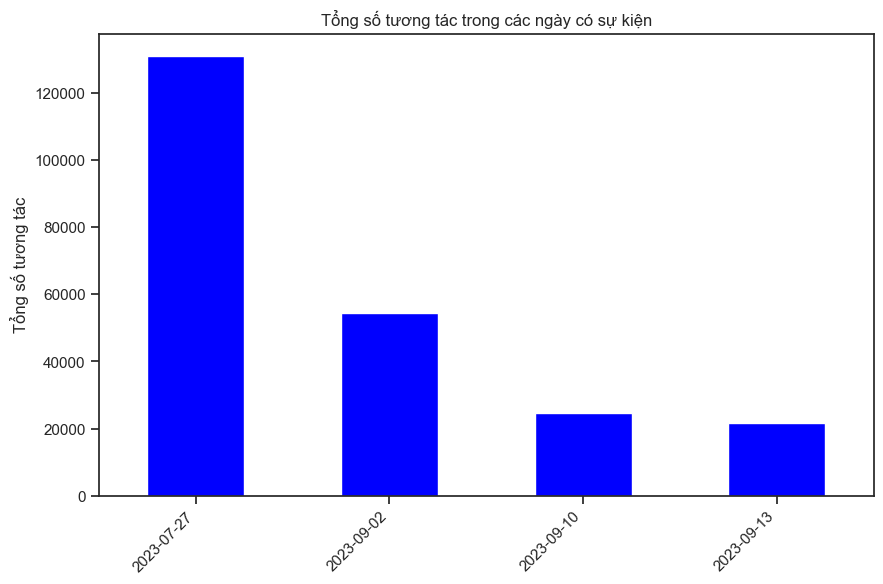

In [152]:
# Specify the specific dates you want to include in the analysis
selected_dates = ['2023-07-27','2023-09-02', '2023-09-10', '2023-09-13']

# Convert the index date to a string and check if it is in the selected dates
selected_posts = df[df.index.strftime('%Y-%m-%d').isin(selected_dates)]
selected_posts_grouped = selected_posts.groupby(selected_posts.index.date)['total_reactions'].sum()

# Plot the total reactions over the selected dates
plt.figure(figsize=(10, 6))
selected_posts_grouped.plot(kind='bar', color='blue')
plt.title('Tổng số tương tác trong các ngày có sự kiện')
plt.xticks(rotation=45, ha='right')
plt.ylabel('Tổng số tương tác')
plt.show()


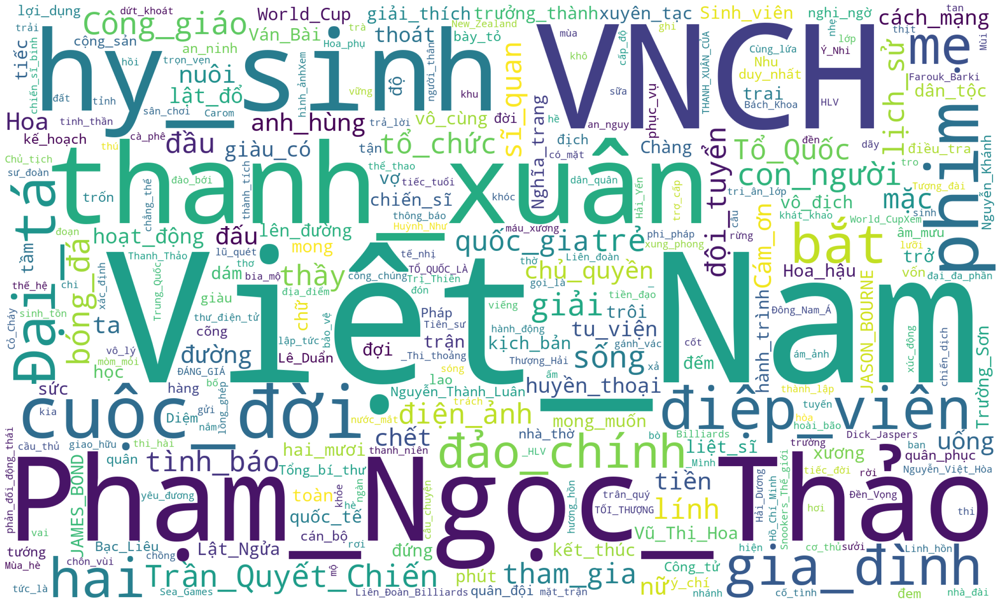

In [161]:
top_5_posts_text = ' '.join(top_5_posts['post_text'].dropna())
top_5_posts_text = word_tokenize(top_5_posts_text, format='text')
key_words(top_5_posts_text)

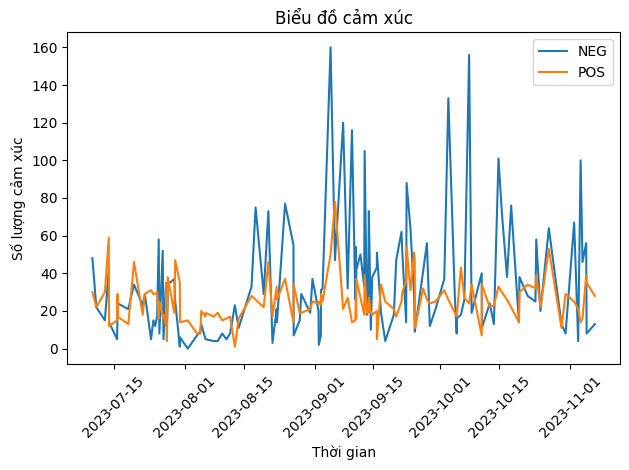

In [28]:
# Tạo cột 'NEG' cho mỗi dòng
df['NEG'] = [sentiment['NEG'] for sentiment in df['comment_sentiment']]

# Tạo cột 'POS' cho mỗi dòng
df['POS'] = [sentiment['POS'] for sentiment in df['comment_sentiment']]

# Vẽ biểu đồ cho cả 'NEG' và 'POS' trên cùng một trục
plt.plot(df['time'], df['NEG'], label='NEG', linestyle='-')
plt.plot(df['time'], df['POS'], label='POS', linestyle='-')

# Đặt tên cho các trục và biểu đồ
plt.xlabel('Thời gian')
plt.ylabel('Số lượng cảm xúc')
plt.title('Biểu đồ cảm xúc')
plt.xticks(rotation=45)
plt.legend()  # Hiển thị chú thích
plt.tight_layout()
plt.show()

In [ ]:
def get_max_sentiment(sentiment):
    max_sentiment = max(sentiment, key=sentiment.get)
    return max_sentiment

In [ ]:
df['count_labels_sentiment'] = [max(sentiment.values()) for sentiment in df['comment_sentiment']]

In [ ]:
df['sentiment_from_comment'] = [get_max_sentiment(sentiment) for sentiment in df['comment_sentiment']]

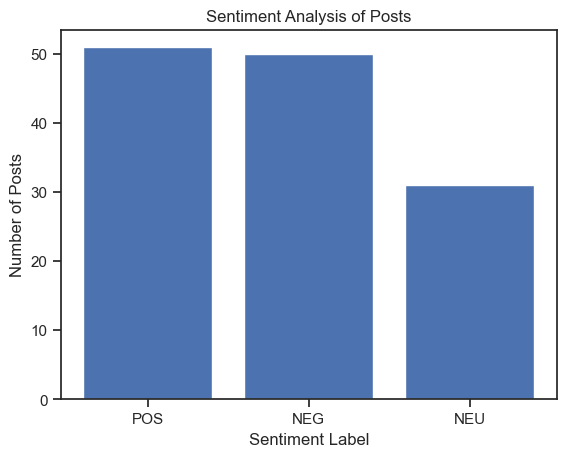

In [ ]:
label_counts = df['sentiment_from_comment'].value_counts()

plt.bar(label_counts.index, label_counts.values)
plt.xlabel('Sentiment Label')
plt.ylabel('Number of Posts')
plt.title('Sentiment Analysis of Posts')
plt.show()

In [ ]:
post_NEG = df[df['sentiment_from_comment'] == 'NEG']

In [ ]:
top_5_posts_neg = post_NEG.nlargest(5, 'count_labels_sentiment')

In [ ]:
top_5_posts_neg

,post_id,post_text,time,images_description,comments,shares,comments_full,reaction_count,image_id,image_ids,...,phẫn nộ,summary,sentiment,max_label,comment_sentiment,total_reactions,NEG,POS,sentiment_from_comment,count_labels_sentiment
62,291061090223151,"GẦN 100.000 ĐỒNG BÀO THIẾU NƯỚC SINH HOẠT, TƯỚ...",2023-09-04 18:25:36,['Có thể là hình ảnh về văn bản'],2888,362,"[{'comment_id': '3428555597395473', 'commenter...",4885,2.910603e+14,['291060346889892'],...,390.0,Gần 100.000 đồng bào gặp hạn hán và 600ha rừng...,"[{'label': 'NEU', 'score': 0.6957508325576782}...",NEU,"{'POS': 50, 'NEG': 160, 'NEU': 94}",8135,160,50,NEG,160
106,308358165160110,TẠI SAO VIỆT NAM CÓ ÍT HCV HƠN SO VỚI THÁI LAN...,2023-10-07 20:24:00,"[""Có thể là hình ảnh về 11 người và văn bản ch...",1380,87,"[{'comment_id': '1712251432611778', 'commenter...",4358,3.083509e+14,['308350885160838'],...,3.0,Nhiều người Việt Nam luôn có một tư duy kỳ lạ ...,"[{'label': 'NEG', 'score': 0.9833231568336487}...",NEG,"{'POS': 24, 'NEG': 156, 'NEU': 107}",5825,156,24,NEG,156
100,305938342068759,BỮA ĂN 26K CỦA LÊ ANH NUÔI VÀ 800K CỦA CÁC VẬN...,2023-10-02 21:28:07,"[""Có thể là hình ảnh về \u200eđậu phụ và \u200...",2000,566,"[{'comment_id': '1029043094909530', 'commenter...",19755,3.059302e+14,['305930235402903'],...,173.0,Bên cạnh một số thông tin về việc 15 triệu đồn...,"[{'label': 'NEG', 'score': 0.9824945330619812}...",NEG,"{'POS': 26, 'NEG': 133, 'NEU': 77}",22321,133,26,NEG,133
64,292579813404612,"HÀNH ĐỘNG VÔ LƯƠNG TÂM CỦA MỘT NHÀ BÁO, MỘT TỜ...",2023-09-07 18:31:02,"[""Có thể là hình ảnh về 3 người và văn bản cho...",953,187,"[{'comment_id': '1762867057501934', 'commenter...",4411,2.925784e+14,['292578360071424'],...,31.0,"Một tờ báo đã dắt mũi hàng chục , hàng trăm ng...","[{'label': 'NEG', 'score': 0.987221896648407},...",NEG,"{'POS': 21, 'NEG': 120, 'NEU': 85}",5551,120,21,NEG,120
66,293683303294263,HỌ ĐANG BẢO VỆ CHÚNG TA CÒN CHÚNG TA NÊN BỚT L...,2023-09-09 21:09:12,"[""Có thể là hình ảnh về \u200e4 người và \u200...",279,27,"[{'comment_id': '318732287202569', 'commenter_...",3426,2.936829e+14,['293682853294308'],...,0.0,Xin đừng nghĩ rằng tay không có thể chống lại ...,"[{'label': 'NEG', 'score': 0.9863020181655884}...",NEG,"{'POS': 14, 'NEG': 116, 'NEU': 46}",3732,116,14,NEG,116


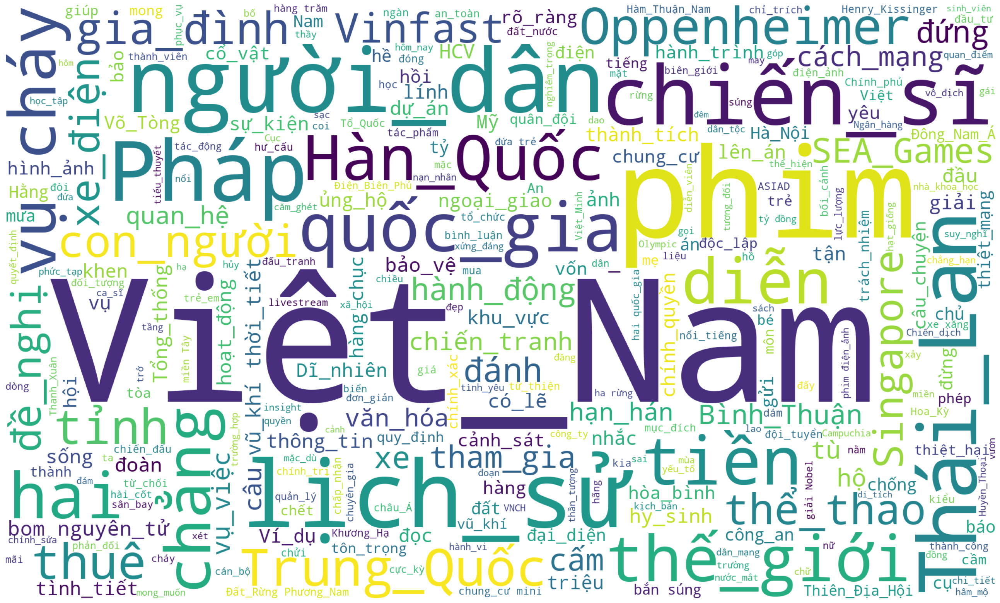

In [ ]:
text_pos = ' '.join(post_NEG['post_text'].dropna())
text_pos = word_tokenize(text_pos, format='text')
key_words(text_pos)

In [ ]:
total_comments_neg = post_NEG['comments_full']

In [ ]:
top_total_comments_neg = top_5_posts_neg['comments_full']

In [45]:
def extract_comment_texts(comments):
    all_comment_texts = []
    for comment in comments:
        all_comment_texts.append(comment['comment_text'])
        if 'replies' in comment:
            # Recursively extract comment texts from replies
            reply_texts = extract_comment_texts(comment['replies'])
            all_comment_texts.extend(reply_texts)
    return all_comment_texts

In [38]:
def get_comment_full(total_comments):
    comment_full = ""
    for comment_i in total_comments:
        comment_i0 = eval(comment_i)
        all_comment_texts = extract_comment_texts(comment_i0)
        for comment_text in all_comment_texts:
            comment_text = word_tokenize(comment_text, format="text")
            comment_full += ' ' + comment_text
    return comment_full

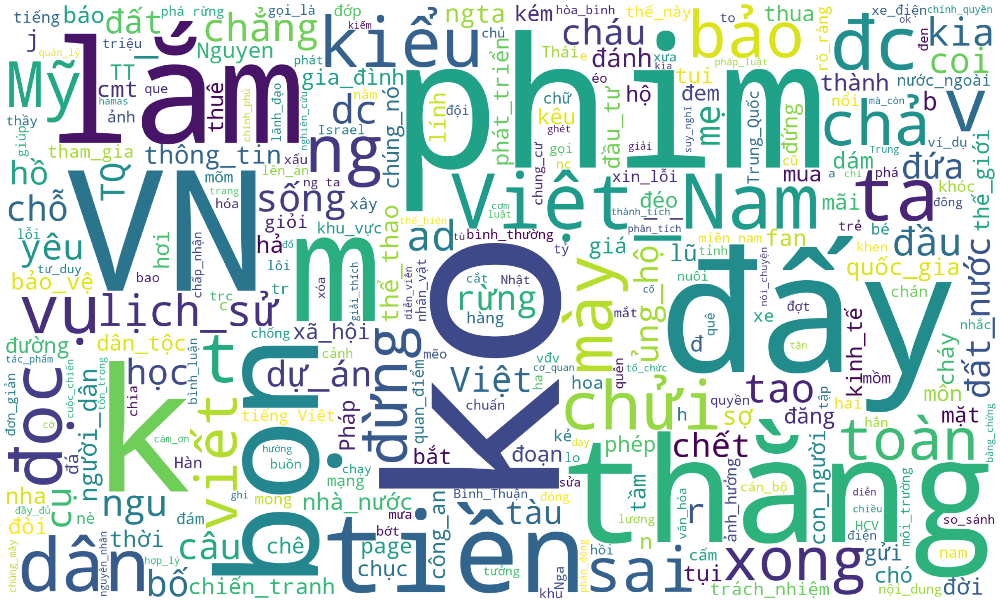

In [ ]:
comment_full_neg = get_comment_full(total_comments_neg)
key_words(comment_full_neg)

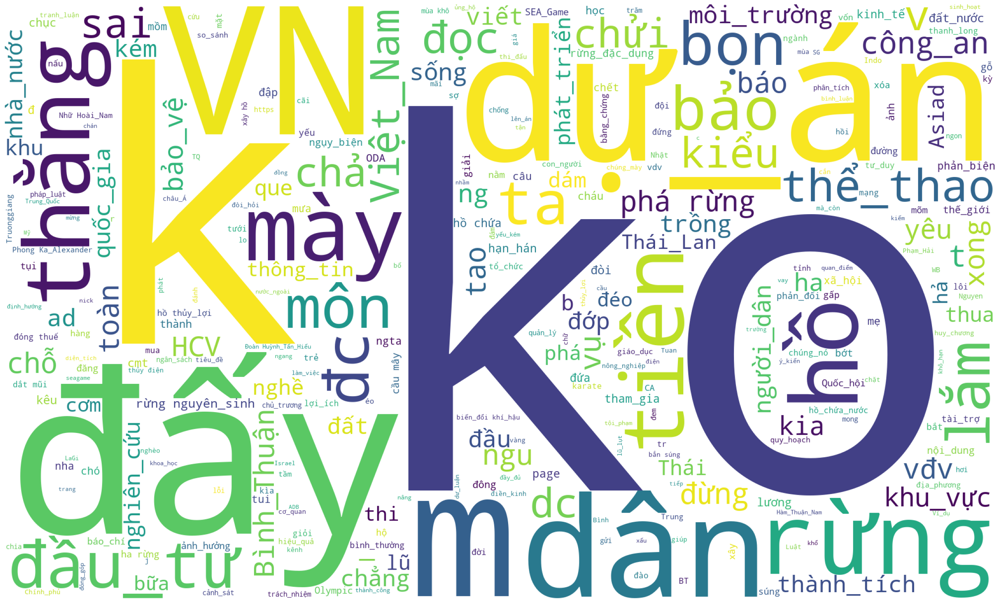

In [ ]:
top_comment_full_neg = get_comment_full(top_total_comments_neg)
key_words(top_comment_full_neg)

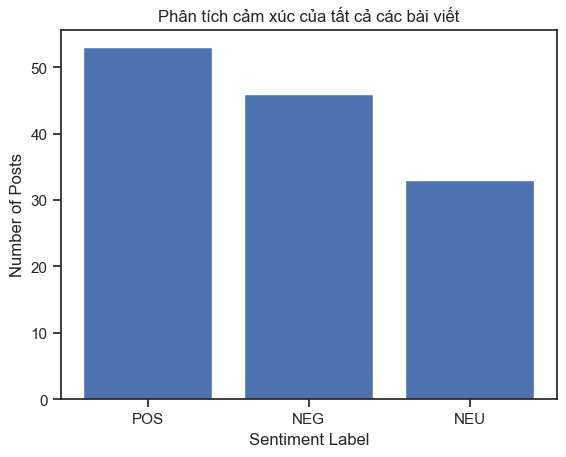

In [ ]:
label_counts = df['max_label'].value_counts()
# Vẽ biểu đồ
plt.bar(label_counts.index, label_counts.values)
plt.xlabel('Sentiment Label')
plt.ylabel('Number of Posts')
plt.title('Phân tích cảm xúc của tất cả các bài viết')
plt.show()

In [ ]:
post_POS = df[df['max_label'] == 'POS']

In [ ]:
comment_POS = post_POS['comments_full']

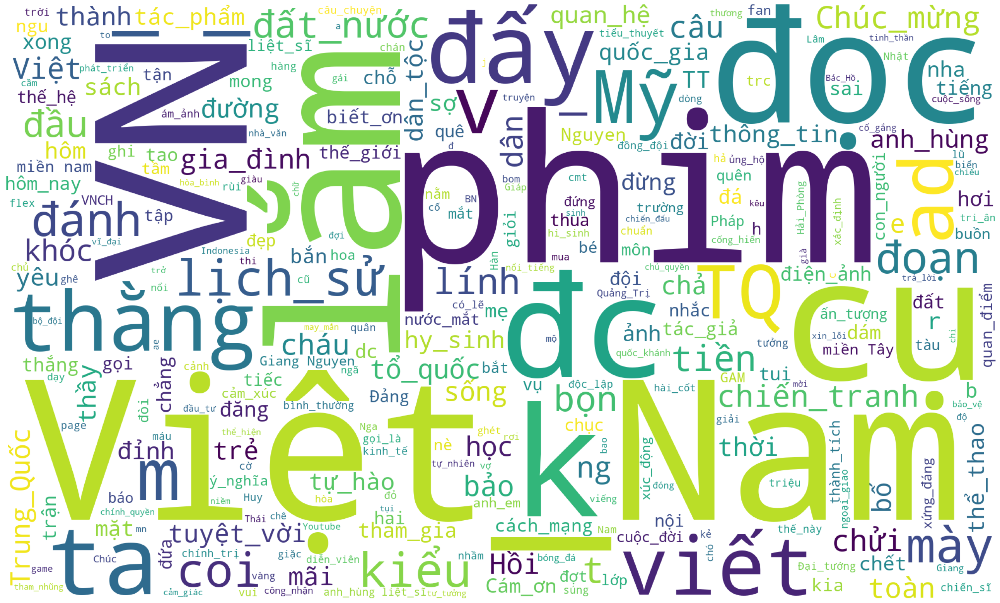

In [ ]:
comment_full_pos = get_comment_full(comment_POS)
key_words(comment_full_pos)

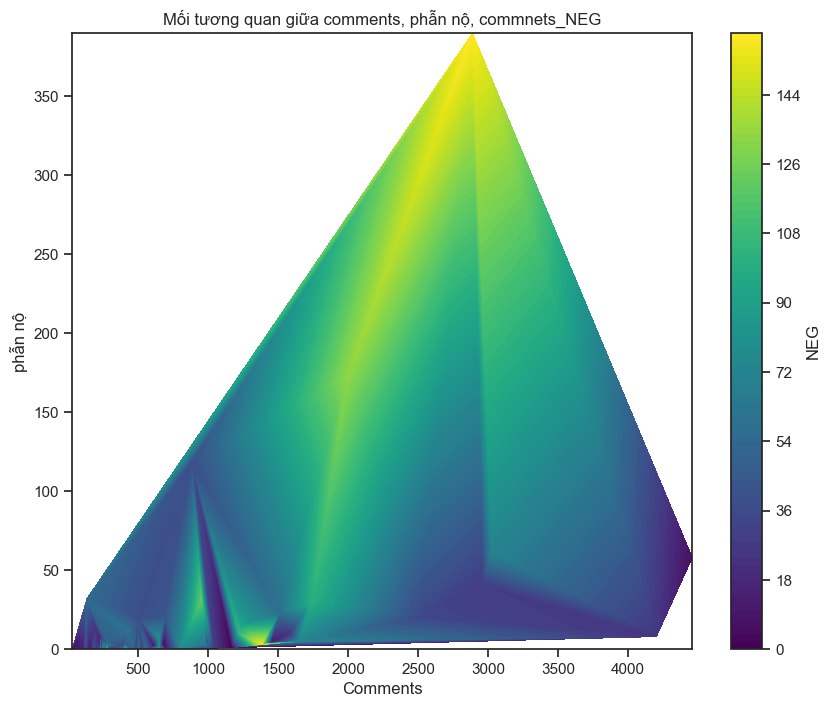

In [ ]:
# Extracting data
z = df['NEG']
x = df['comments']
y = df['phẫn nộ']

# Creating a contour plot with more levels for smoother appearance
plt.figure(figsize=(10, 8))
contour = plt.tricontourf(x, y, z, cmap='viridis', levels=100)  # You can adjust levels for smoother appearance

# Adding colorbar for reference
plt.colorbar(contour, label='NEG')

# Adding labels and title
plt.xlabel('Comments')
plt.ylabel('phẫn nộ')
plt.title('Mối tương quan giữa comments, phẫn nộ, commnets_NEG')

# Show the plot
plt.show()

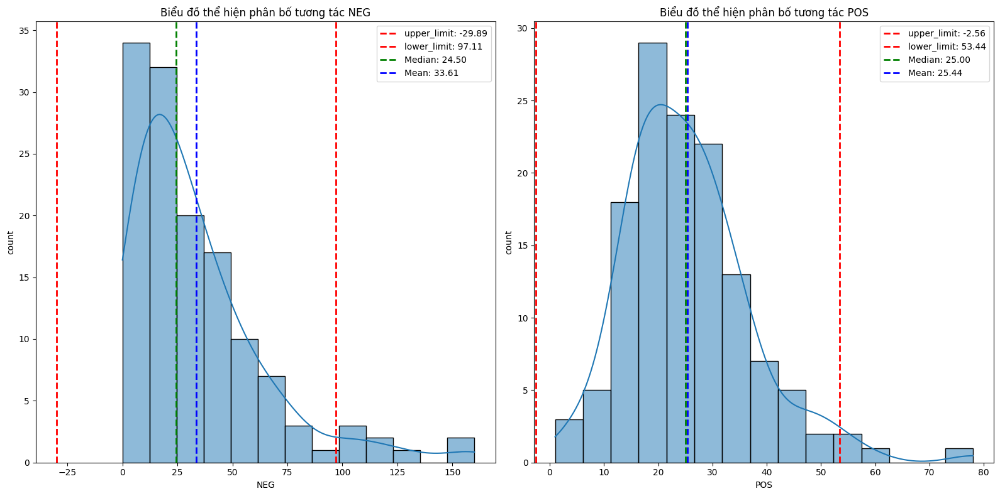

In [29]:
selected_col = ['NEG', 'POS']

fig, ax = plt.subplots(1, 2, figsize=(16, 8))

# Flatten the axes array for easier indexing
ax = ax.flatten()

for i, column in enumerate(selected_col):
    iqr = df[column].quantile(.75) - df[column].quantile(.25)
    upper_limit = df[column].mean() + 2 * iqr
    lower_limit = df[column].mean() - 2 * iqr
    median_value = df[column].median()
    mean_value = df[column].mean()
    
    # Plot histogram
    sns.histplot(df[column], kde=True, ax=ax[i])
    
    # Overlay lines indicating two standard deviations
    ax[i].axvline(lower_limit, color='red', linestyle='dashed', linewidth=2, label=f'upper_limit: {lower_limit:.2f}')
    ax[i].axvline(upper_limit, color='red', linestyle='dashed', linewidth=2, label=f'lower_limit: {upper_limit:.2f}')
    ax[i].axvline(median_value, color='green', linestyle='dashed', linewidth=2, label=f'Median: {median_value:.2f}')
    ax[i].axvline(mean_value, color='blue', linestyle='dashed', linewidth=2, label=f'Mean: {mean_value:.2f}')
    
    # Add icon to the title
    ax[i].set_title(f'Biểu đồ thể hiện phân bố tương tác {column}')
    ax[i].set_xlabel(column)
    ax[i].set_ylabel('count')
    ax[i].legend()

plt.tight_layout()  # To improve subplot layout
plt.show()

In [ ]:
def scale_data(data):
    percentile_10 = np.percentile(data, 10)
    percentile_90 = np.percentile(data, 90)
    # Lọc giá trị trong khoảng từ 10% đến 90%
    filtered_data = data[(data >= percentile_10) & (data <= percentile_90)]
    return filtered_data

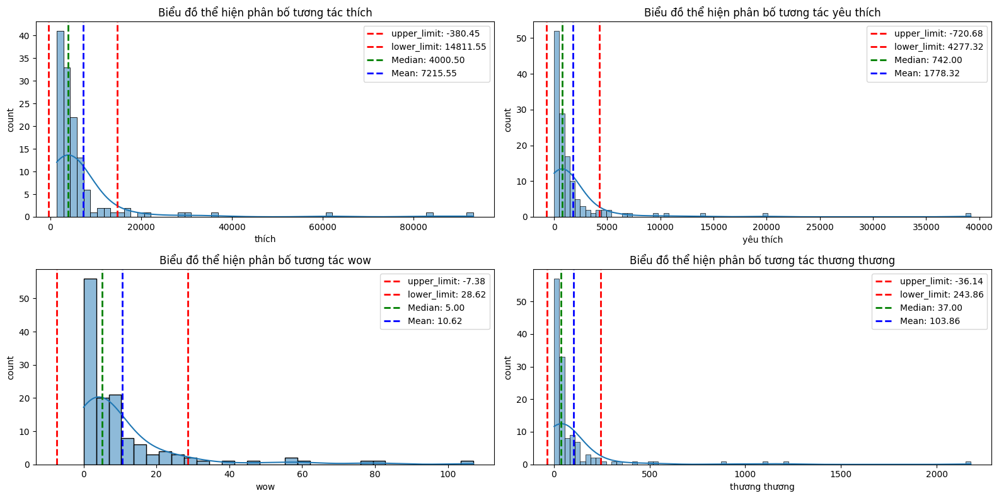

In [ ]:
selected_col = ['thích', 'yêu thích', 'wow', 'thương thương']

fig, ax = plt.subplots(2, 2, figsize=(16, 8))

# Flatten the axes array for easier indexing
ax = ax.flatten()

for i, column in enumerate(selected_col):
    iqr = df[column].quantile(.75) - df[column].quantile(.25)
    upper_limit = df[column].mean() + 2 * iqr
    lower_limit = df[column].mean() - 2 * iqr
    median_value = df[column].median()
    mean_value = df[column].mean()
    
    # Plot histogram
    sns.histplot(df[column], kde=True, ax=ax[i])
    
    # Overlay lines indicating two standard deviations
    ax[i].axvline(lower_limit, color='red', linestyle='dashed', linewidth=2, label=f'upper_limit: {lower_limit:.2f}')
    ax[i].axvline(upper_limit, color='red', linestyle='dashed', linewidth=2, label=f'lower_limit: {upper_limit:.2f}')
    ax[i].axvline(median_value, color='green', linestyle='dashed', linewidth=2, label=f'Median: {median_value:.2f}')
    ax[i].axvline(mean_value, color='blue', linestyle='dashed', linewidth=2, label=f'Mean: {mean_value:.2f}')
    
    # Add icon to the title
    ax[i].set_title(f'Biểu đồ thể hiện phân bố tương tác {column}')
    ax[i].set_xlabel(column)
    ax[i].set_ylabel('count')
    ax[i].legend()

plt.tight_layout()  # To improve subplot layout
plt.show()

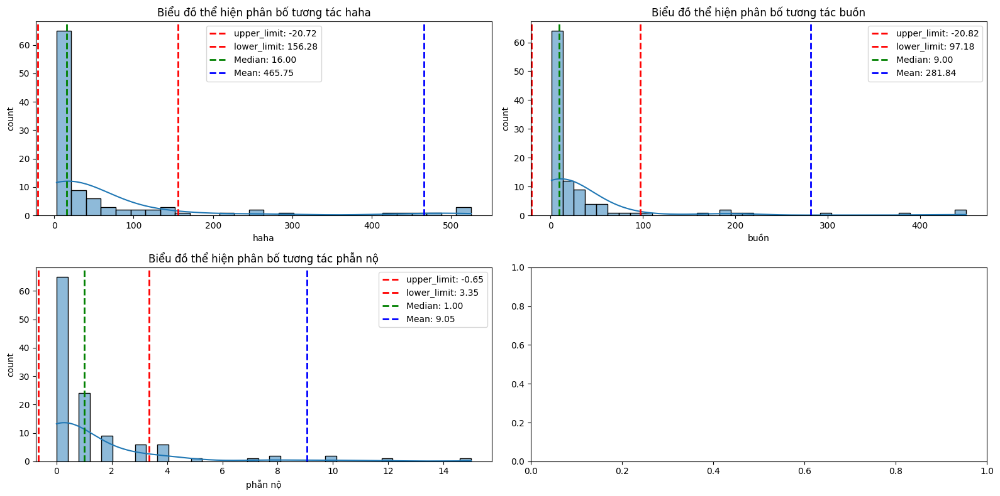

In [ ]:
selected_col = ['haha', 'buồn', 'phẫn nộ']

fig, ax = plt.subplots(2, 2, figsize=(16, 8))

# Flatten the axes array for easier indexing
ax = ax.flatten()

for i, column in enumerate(selected_col):
    data = scale_data(df[column])
    iqr = data.quantile(.75) - data.quantile(.25)
    upper_limit = data.mean() + 2 * iqr
    lower_limit = data.mean() - 2 * iqr
    median_value = df[column].median()
    mean_value = df[column].mean()
    
    # Plot histogram
    sns.histplot(data, kde=True, ax=ax[i])
    
    # Overlay lines indicating two standard deviations
    ax[i].axvline(lower_limit, color='red', linestyle='dashed', linewidth=2, label=f'upper_limit: {lower_limit:.2f}')
    ax[i].axvline(upper_limit, color='red', linestyle='dashed', linewidth=2, label=f'lower_limit: {upper_limit:.2f}')
    ax[i].axvline(median_value, color='green', linestyle='dashed', linewidth=2, label=f'Median: {median_value:.2f}')
    ax[i].axvline(mean_value, color='blue', linestyle='dashed', linewidth=2, label=f'Mean: {mean_value:.2f}')
    
    
    ax[i].set_title(f'Biểu đồ thể hiện phân bố tương tác {column}')
    ax[i].set_xlabel(column)
    ax[i].set_ylabel('count')
    ax[i].legend()

plt.tight_layout()  # To improve subplot layout
plt.show()

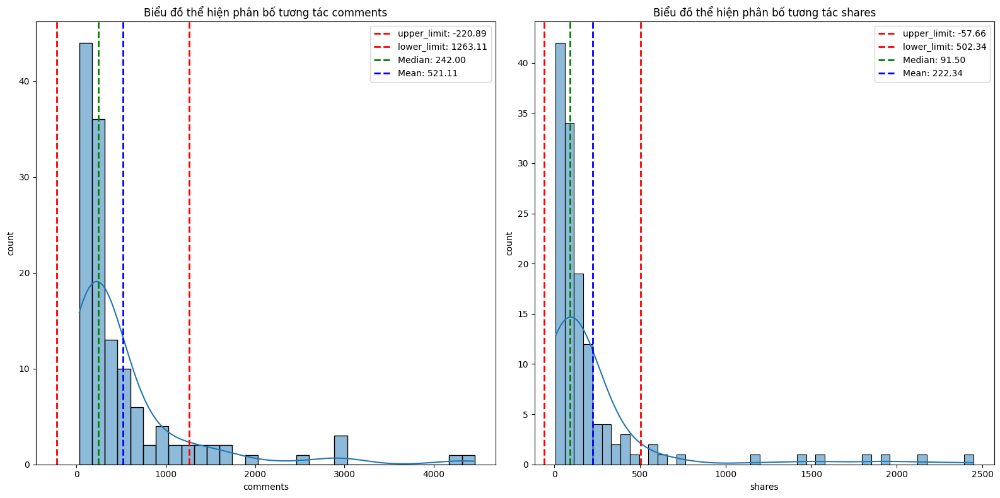

In [ ]:
selected_col = ['comments', 'shares']

fig, ax = plt.subplots(1, 2, figsize=(16, 8))

# Flatten the axes array for easier indexing
ax = ax.flatten()

for i, column in enumerate(selected_col):
    iqr = df[column].quantile(.75) - df[column].quantile(.25)
    upper_limit = df[column].mean() + 2 * iqr
    lower_limit = df[column].mean() - 2 * iqr
    median_value = df[column].median()
    mean_value = df[column].mean()
    
    # Plot histogram
    sns.histplot(df[column], kde=True, ax=ax[i])
    
    # Overlay lines indicating two standard deviations
    ax[i].axvline(lower_limit, color='red', linestyle='dashed', linewidth=2, label=f'upper_limit: {lower_limit:.2f}')
    ax[i].axvline(upper_limit, color='red', linestyle='dashed', linewidth=2, label=f'lower_limit: {upper_limit:.2f}')
    ax[i].axvline(median_value, color='green', linestyle='dashed', linewidth=2, label=f'Median: {median_value:.2f}')
    ax[i].axvline(mean_value, color='blue', linestyle='dashed', linewidth=2, label=f'Mean: {mean_value:.2f}')
    
    # Add icon to the title
    ax[i].set_title(f'Biểu đồ thể hiện phân bố tương tác {column}')
    ax[i].set_xlabel(column)
    ax[i].set_ylabel('count')
    ax[i].legend()

plt.tight_layout()  # To improve subplot layout
plt.show()

In [ ]:
df[df['sentiment_from_comment'] == df['max_label']].shape[0]

65

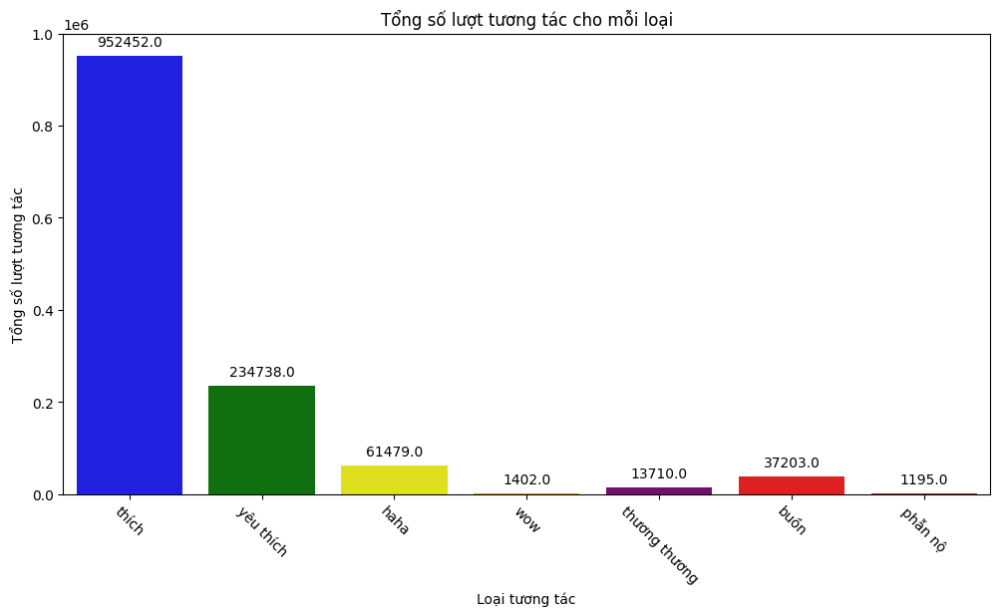

In [31]:
selected_columns = ['thích', 'yêu thích', 'haha', 'wow', 'thương thương', 'buồn', 'phẫn nộ']
# Màu sắc tương ứng với từng loại cảm xúc
emotion_colors = {'thích': 'blue', 'yêu thích': 'green', 'haha': 'yellow', 'wow': 'orange', 'thương thương': 'purple', 'buồn': 'red', 'phẫn nộ': 'brown'}

# Tạo DataFrame mới với các cột tương tác
reactions_df = df[selected_columns].copy()

# Tính tổng số lượt tương tác cho mỗi loại
total_reactions = reactions_df.sum()

# Vẽ biểu đồ với tô màu theo sắc thái cảm xúc
plt.figure(figsize=(12, 6))
barplot = sns.barplot(x=total_reactions.index, y=total_reactions.values, palette=[emotion_colors[col] for col in total_reactions.index])

# Thêm chú thích về sắc thái cảm xúc tương ứng
for p in barplot.patches:
    barplot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.title('Tổng số lượt tương tác cho mỗi loại')
plt.xlabel('Loại tương tác')
plt.ylabel('Tổng số lượt tương tác')
plt.xticks(rotation=-45)
plt.show()

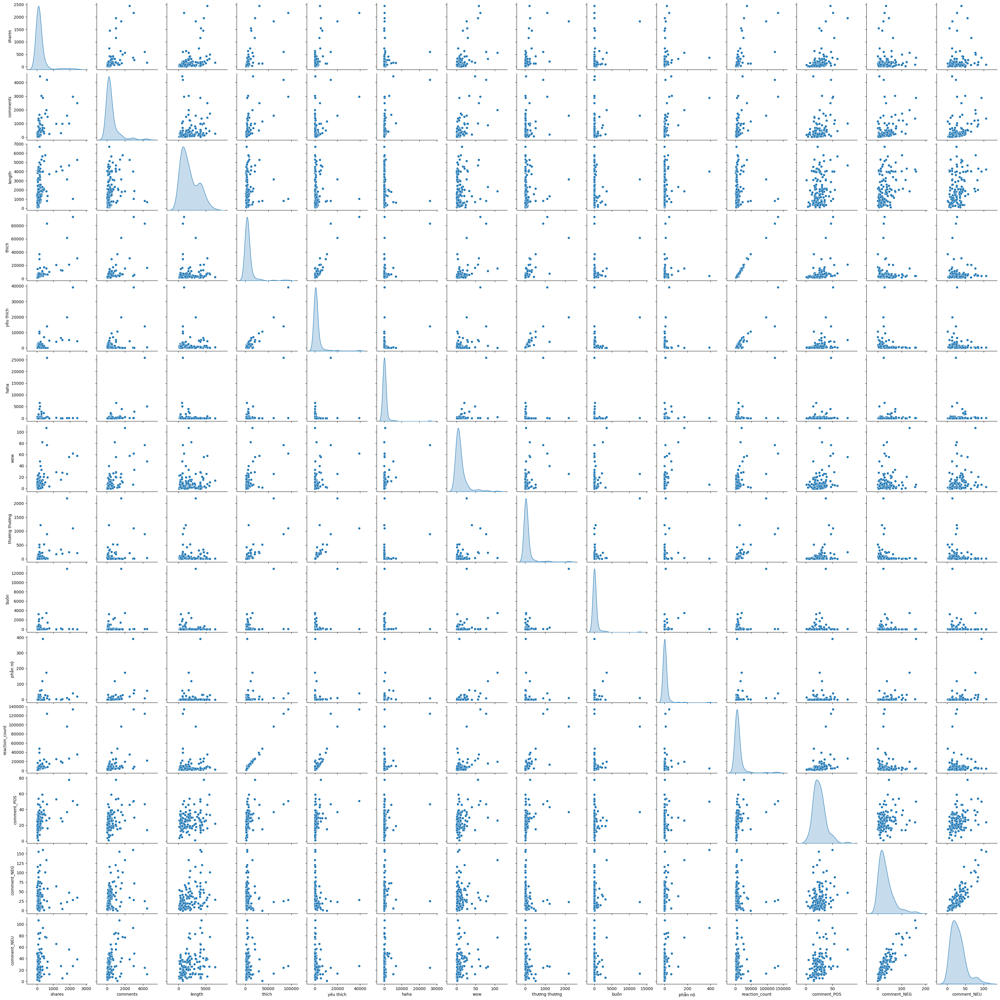

In [8]:
sns.pairplot(df[['shares', 'comments', 'length','thích', 'yêu thích', 'haha', 'wow', 'thương thương', 'buồn', 'phẫn nộ','reaction_count','comment_POS','comment_NEG','comment_NEU']], diag_kind='kde')

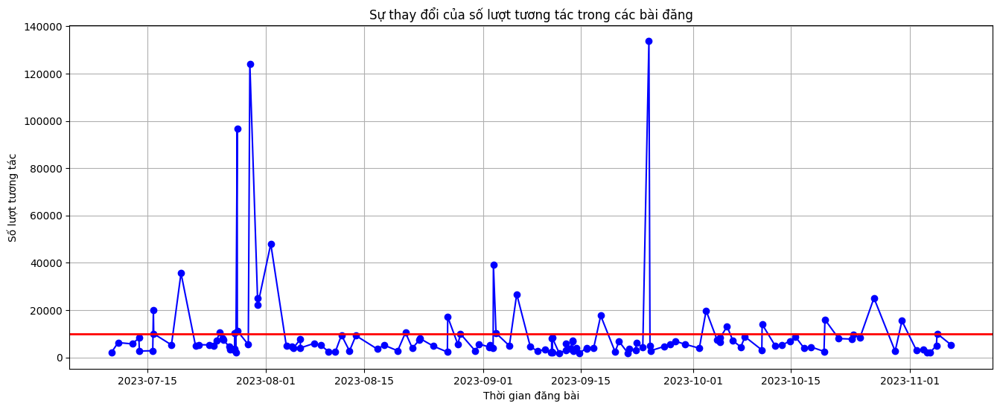

In [11]:
plt.figure(figsize=(16, 6))
plt.plot(df['time'], df['reaction_count'], marker='o', color='b')
plt.xlabel('Thời gian đăng bài')
plt.ylabel('Số lượt tương tác')
plt.title('Sự thay đổi của số lượt tương tác trong các bài đăng')
plt.grid(True)
plt.axhline(df['reaction_count'].mean(), color='red', linewidth=2, label='Trung vị')
plt.show()

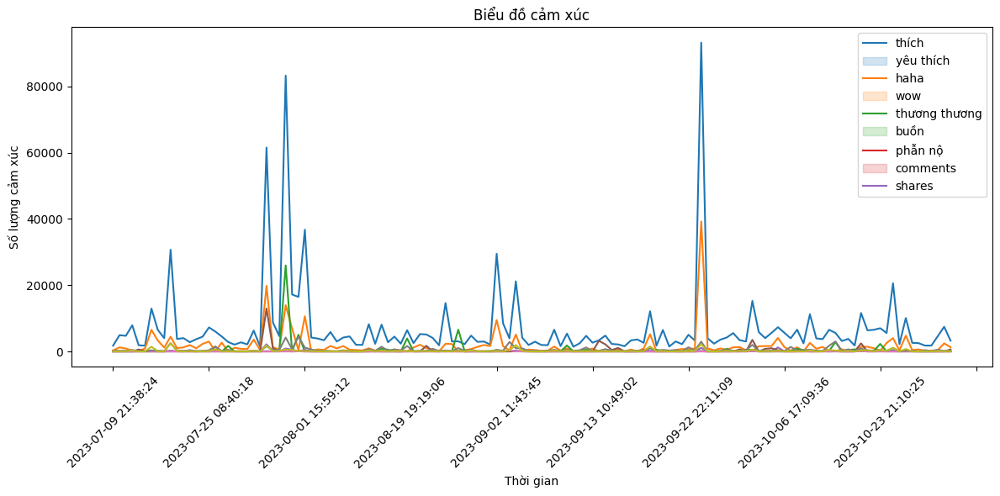

In [24]:
selected_columns = ['thích', 'yêu thích', 'haha', 'wow', 'thương thương', 'buồn', 'phẫn nộ', 'comments', 'shares']

# Assuming 'time' is the column representing time in your DataFrame
plt.figure(figsize=(12, 6))

# Use Seaborn lineplot to plot multiple lines
sns.lineplot(data=df[selected_columns], dashes=False)

# Set labels for axes and the plot
plt.xlabel('Thời gian')
plt.ylabel('Số lượng cảm xúc')
plt.title('Biểu đồ cảm xúc')

# Adjust the x-axis ticks
plt.xticks(rotation=45)
plt.gca().xaxis.set_major_locator(plt.MaxNLocator(10))  # Set the maximum number of ticks to 10

plt.legend(selected_columns)  # Display legend with selected column names
plt.tight_layout()
plt.show()

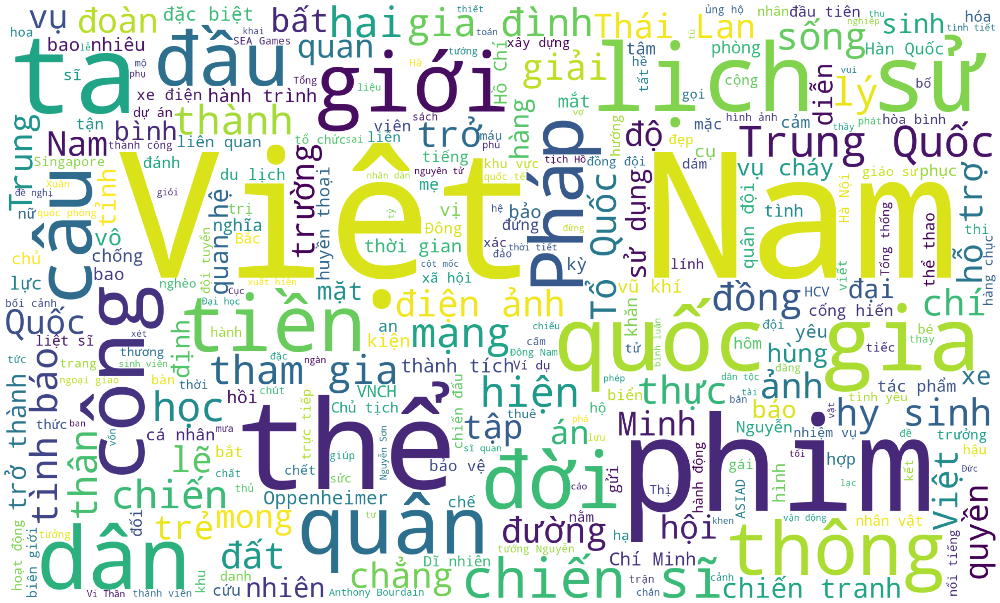

In [35]:
text = ' '.join(df['post_text'].dropna())
key_words(text)

In [43]:
total_comments = df['comments_full']

In [ ]:
comment_full = get_comment_full(total_comments)

In [ ]:
key_words(comment_full)

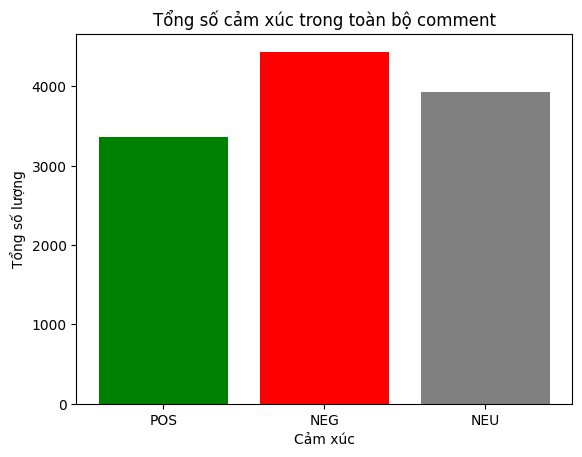

In [47]:
comment_sentiment = df['comment_sentiment']

# Tính tổng số cảm xúc cho mỗi loại trên toàn bộ DataFrame
total_sentiment = {'POS': 0, 'NEG': 0, 'NEU': 0}

for comment in comment_sentiment:
    for emotion, count in comment.items():
        total_sentiment[emotion] += count

# Chuyển đổi dữ liệu thành DataFrame để dễ vẽ biểu đồ
total_df = pd.DataFrame(list(total_sentiment.items()), columns=['Emotion', 'Total'])

# Vẽ biểu đồ cột
plt.bar(total_df['Emotion'], total_df['Total'], color=['green', 'red', 'gray'])
plt.xlabel('Cảm xúc')
plt.ylabel('Tổng số lượng')
plt.title('Tổng số cảm xúc trong toàn bộ comment')
plt.show()